In [1]:
import pandas as pd
import plotly.express as px
import yfinance as yf

In [ ]:
df = pd.read_excel(
    "files/PET_PRI_SPT_S1_D.xls", 
    sheet_name="Data 1",
    skiprows=9,
    header=None,
    parse_dates=[0])
df.columns=['date', 'wti', 'brent']
df = df.set_index('date')
spot = df.wti
_ = spot.plot()

In [ ]:
uso = yf.download("USO", start="1970-01-01", progress=False)["Close"]
_ = uso.plot()

In [ ]:
df = pd.concat((spot, uso), axis=1).dropna()
df.columns = ["spot", "uso"]
df = df.divide(df.iloc[0])
_ = df.plot()

In [4]:
futures = pd.read_csv("files/crude_futures.csv", index_col=["date", "days"])

In [9]:
futures.unstack("days")

ValueError: Index contains duplicate entries, cannot reshape

In [ ]:

import plotly.express as px
fig = px.line(
  futures,
  x="days",
  y="settle",
  animation_frame="date",
)
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 10
fig.update_yaxes(range=[0.99*df.settle.min(), 1.01*df.settle.max()])
fig.update_xaxes(range=[0, df.days.max()])
fig.update_yaxes(tickformat=".0f", title="WTI Futures Settle")
fig.update_xaxes(title="Days to Maturity")
fig.layout.template = "simple_white"

In [2]:

fig = px.scatter(
        d2,
        x='months',
        y='settle',
        animation_frame='date'
    )

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,320.320007,322.399994,318.959991,322.160004,322.160004,1426038
2010-01-05,322.000000,323.600006,319.440002,323.279999,323.279999,1306275
2010-01-06,322.559998,329.519989,319.119995,327.760010,327.760010,2473725
2010-01-07,326.959991,328.640015,325.440002,325.760010,325.760010,1252963
2010-01-08,325.040009,329.359985,323.600006,327.440002,327.440002,1174188


In [1]:
fig.show()

NameError: name 'fig' is not defined

In [10]:
from sqlalchemy import create_engine
import pymssql
server = 'fs.rice.edu'
database = 'futures'
username = 'futures'
password = 'RCGCMO'

string = "mssql+pymssql://" + username + ":" + password + "@" + server + "/" + database 
conn = create_engine(string).connect()

In [39]:
codes = ['F', 'G', 'H', 'J', 'K', 'M', 'N', 'Q', 'U', 'V', 'X', 'Z']
def read_code(x):
    x = x.split(_)[1]
    year = x[-4:]
    month = x[-5]
    month = str(codes.index(month)+1)
    month = month if len(month)==2 else "0"+month
    expiry = year + "-" + month
    underlying = x[:-5]
    return underlying, expiry

In [17]:
meta = pd.read_sql("select * from metadata where code like 'CME_CL%' ", 
    conn,
    parse_dates=["to_date"]
)
daily = pd.read_sql("select * from data where code like 'CME_CL%' ", 
    conn,
    parse_dates="date"
)
df = daily.merge(meta, on="code", how="left")
df = df.sort_values(by=["date", "to_date"])
days = (df.to_date-df.date).astype(str)
df["days"] = [x.split()[0] for x in days]
df = df[["code", "date", "days", "settle"]]

In [18]:
df.dtypes

code              object
date      datetime64[ns]
days              object
settle           float64
dtype: object

In [12]:
df.to_csv("files/crude_futures.csv", index=False)

In [21]:
df = df.groupby("code", group_keys=False).apply(lambda d:  
    d.set_index("date").resample("M").last()
)
df = df.sort_values(by="code")
df.to_csv("files/crude_futures_monthly.csv")


: 

In [63]:
fig = px.scatter(
        df,
        x='days',
        y='settle',
        animation_frame='date'
    )
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 200

In [64]:
fig.show()

<AxesSubplot:xlabel='to_maturity'>

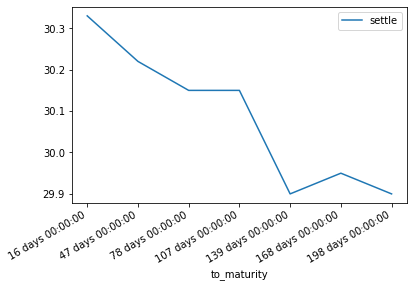

In [55]:
date = "1983-06-01"
d = df[df.date.astype(str)==date][["to_maturity", "settle"]].set_index("to_maturity")
d.plot()

In [49]:
df = df.sort_values(by=["date", "to_maturity"])

In [47]:
from datetime import timedelta

df["to_maturity"] = df.to_date - df.date

In [48]:
df.head()

,code,date,open_,high,low,settle,volume,open_interest,name,description,from_date,to_date,to_maturity
0,CME_CLF1984,1983-06-01,29.750000,29.900000,29.750000,29.900000,12.0,12.0,"NYMEX WTI Crude Oil, January 1984 (CLF1984)","Contract Size:1,000 barrels Deliverable Good:...",1983-06-01,1983-12-16,198 days
1,CME_CLF1984,1983-06-02,29.900000,29.900000,29.900000,29.900000,0.0,12.0,"NYMEX WTI Crude Oil, January 1984 (CLF1984)","Contract Size:1,000 barrels Deliverable Good:...",1983-06-01,1983-12-16,197 days
2,CME_CLF1984,1983-06-03,29.850000,29.850000,29.850000,29.850000,0.0,12.0,"NYMEX WTI Crude Oil, January 1984 (CLF1984)","Contract Size:1,000 barrels Deliverable Good:...",1983-06-01,1983-12-16,196 days
3,CME_CLF1984,1983-06-06,29.850000,29.850000,29.850000,29.850000,0.0,12.0,"NYMEX WTI Crude Oil, January 1984 (CLF1984)","Contract Size:1,000 barrels Deliverable Good:...",1983-06-01,1983-12-16,193 days
4,CME_CLF1984,1983-06-07,30.049999,30.049999,30.049999,30.049999,0.0,12.0,"NYMEX WTI Crude Oil, January 1984 (CLF1984)","Contract Size:1,000 barrels Deliverable Good:...",1983-06-01,1983-12-16,192 days


In [36]:
d2 = pd.read_sql(
    "select * from data where code like 'CME_CL%' ",
    conn
)
d2

,code,date,open_,high,low,settle,volume,open_interest
0,CME_CLF1984,1983-06-01,29.750000,29.900000,29.750000,29.900000,12.0,12.0
1,CME_CLF1984,1983-06-02,29.900000,29.900000,29.900000,29.900000,0.0,12.0
2,CME_CLF1984,1983-06-03,29.850000,29.850000,29.850000,29.850000,0.0,12.0
3,CME_CLF1984,1983-06-06,29.850000,29.850000,29.850000,29.850000,0.0,12.0
4,CME_CLF1984,1983-06-07,30.049999,30.049999,30.049999,30.049999,0.0,12.0
...,...,...,...,...,...,...,...,...
489173,CME_CLZ2032,2022-06-23,63.320000,63.320000,63.320000,63.320000,0.0,0.0
489174,CME_CLZ2032,2022-06-24,65.269997,65.269997,65.269997,65.269997,0.0,0.0
489175,CME_CLZ2032,2022-06-27,66.419998,66.419998,66.419998,66.419998,0.0,0.0
489176,CME_CLZ2032,2022-06-28,67.910004,67.910004,67.910004,67.910004,0.0,0.0


In [4]:
df = pd.read_sql(
    """
    select * from sf1 
    where ticker='AAPL' and dimension='ARY'
    order by reportperiod
    """, 
    conn
)
df

,ticker,dimension,calendardate,datekey,reportperiod,lastupdated,accoci,assets,assetsavg,assetsc,...,sharesbas,shareswa,shareswadil,sps,tangibles,taxassets,taxexp,taxliabilities,tbvps,workingcapital


In [5]:
df = pd.read_sql(
    """
    select * from sf1 
    where ticker in ('AAPL', 'CVX') and dimension='ARQ' and reportperiod>='2020-01-01'
    order by ticker, reportperiod
    """, 
    conn
)
df

,ticker,dimension,calendardate,datekey,reportperiod,lastupdated,accoci,assets,assetsavg,assetsc,...,sharesbas,shareswa,shareswadil,sps,tangibles,taxassets,taxexp,taxliabilities,tbvps,workingcapital


In [6]:
df = pd.read_sql(
    """
    select * from sep where ticker='AAPL' 
    order by date
    """,
    conn
)
df

,ticker,date,lastupdated,open_,high,low,close_,volume,closeadj,closeunadj
0,AAPL,1997-12-31,2022-12-27,0.117,0.122,0.116,0.117,4.063584e+08,0.100,13.13
1,AAPL,1998-01-02,2022-12-27,0.122,0.145,0.120,0.145,7.181104e+08,0.123,16.25
2,AAPL,1998-01-05,2022-12-27,0.147,0.148,0.136,0.142,6.518736e+08,0.121,15.88
3,AAPL,1998-01-06,2022-12-27,0.142,0.178,0.132,0.169,1.812474e+09,0.144,18.94
4,AAPL,1998-01-07,2022-12-27,0.168,0.170,0.154,0.156,1.041622e+09,0.133,17.50
...,...,...,...,...,...,...,...,...,...,...
6296,AAPL,2023-01-09,2023-01-09,130.465,133.410,129.890,130.150,7.049660e+07,130.150,130.15
6297,AAPL,2023-01-10,2023-01-10,130.260,131.264,128.120,130.730,6.342765e+07,130.730,130.73
6298,AAPL,2023-01-11,2023-01-11,131.250,133.510,130.460,133.490,6.911440e+07,133.490,133.49
6299,AAPL,2023-01-12,2023-01-12,133.880,134.260,131.440,133.410,7.124770e+07,133.410,133.41


In [7]:
df = pd.read_sql(
    """
    select * from daily where ticker='AAPL' 
    order by date
    """,
    conn
)
df

,ticker,date,lastupdated,ev,evebit,evebitda,marketcap,pb,pe,ps
0,AAPL,1998-12-01,2020-08-31,4349.3,-4.2,-4.7,4599.3,3.1,-4.4,0.6
1,AAPL,1998-12-02,2020-08-31,4605.6,-4.4,-5.0,4855.6,3.3,-4.6,0.7
2,AAPL,1998-12-03,2020-08-31,4289.0,-4.1,-4.6,4539.0,3.1,-4.3,0.6
3,AAPL,1998-12-04,2020-08-31,4153.2,-4.0,-4.5,4403.2,3.0,-4.2,0.6
4,AAPL,1998-12-07,2020-08-31,4289.0,-4.1,-4.6,4539.0,3.1,-4.3,0.6
...,...,...,...,...,...,...,...,...,...,...
6065,AAPL,2023-01-09,2023-01-09,2166864.6,17.8,16.3,2070441.6,40.9,20.7,5.3
6066,AAPL,2023-01-10,2023-01-10,2176091.3,17.8,16.3,2079668.3,41.0,20.8,5.3
6067,AAPL,2023-01-11,2023-01-11,2219997.7,18.2,16.7,2123574.7,41.9,21.3,5.4
6068,AAPL,2023-01-12,2023-01-12,2218725.0,18.2,16.7,2122302.0,41.9,21.3,5.4
